<h1><center>Laboratorio 6: La solicitud de Sergio 🤗</center></h1>

<center><strong>MDS7202: Laboratorio de Programación Científica para Ciencia de Datos - Primavera 2024</strong></center>

### Cuerpo Docente:

- Profesores: Ignacio Meza, Sebastián Tinoco
- Auxiliar: Eduardo Moya
- Ayudantes: Nicolás Ojeda, Melanie Peña, Valentina Rojas

### Equipo: SUPER IMPORTANTE - notebooks sin nombre no serán revisados

- Nombre de alumno 1: Sivert Escaff
- Nombre de alumno 2: Rodrigo Montecinos

### **Link de repositorio de GitHub:** [Insertar Repositorio](https://github.com/...../)

## Temas a tratar
- Aplicar Pandas para obtener características de un DataFrame.
- Aplicar Pipelines y Column Transformers.
- Utilizar diferentes algoritmos de cluster y ver el desempeño.

## Reglas:

- **Grupos de 2 personas**
- Cualquier duda fuera del horario de clases al foro. Mensajes al equipo docente serán respondidos por este medio.
- Prohibidas las copias.
- Pueden usar cualquer matrial del curso que estimen conveniente.
- Código que no se pueda ejecutar, no será revisado.

### Objetivos principales del laboratorio
- Comprender cómo aplicar pipelines de Scikit-Learn para generar clusters.
- Familiarizarse con plotly.

El laboratorio deberá ser desarrollado sin el uso indiscriminado de iteradores nativos de python (aka "for", "while"). La idea es que aprendan a exprimir al máximo las funciones optimizadas que nos entrega `numpy`, las cuales vale mencionar, son bastante más eficientes que los iteradores nativos sobre arreglos (*o tensores*).

## Descripción del laboratorio

<center>
<img src="https://i.pinimg.com/originals/5a/a6/af/5aa6afde8490da403a21601adf7a7240.gif" width=400 />

En el corazón de las operaciones de Aerolínea Lucero, Sergio, el gerente de análisis de datos, reunió a un talentoso equipo de jóvenes científicos de datos para un desafío crucial: segmentar la base de datos de los clientes. “Nuestro objetivo es descubrir patrones en el comportamiento de los pasajeros que nos permitan personalizar servicios y optimizar nuestras campañas de marketing,” explicó Sergio, mientras desplegaba un amplio rango de datos que incluían desde hábitos de compra hasta opiniones sobre los vuelos.

Sergio encargó a los científicos de datos la tarea de aplicar técnicas avanzadas de clustering para identificar distintos segmentos de clientes, como los viajeros frecuentes y aquellos que eligen la aerolínea para celebrar ocasiones especiales. La meta principal era entender profundamente cómo estos grupos perciben la calidad y satisfacción de los servicios ofrecidos por la aerolínea.

A través de un enfoque meticuloso y colaborativo, los científicos de datos se abocaron a la tarea, buscando transformar los datos brutos en valiosos insights que permitirían a Aerolínea Lucero no solo mejorar su servicio, sino también fortalecer las relaciones con sus clientes mediante una oferta más personalizada y efectiva.

## Importamos librerias utiles 😸

In [5]:
import numpy as np
import pandas as pd

from sklearn import datasets

import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

## 1. Estudio de Performance 📈 [10 Puntos]



<center>
<img src="https://user-images.githubusercontent.com/57133330/188281408-c67df9ee-fd1f-4b37-833b-f02848f1ce02.gif" width=300>

Don Sergio les ha encomendado su primera tarea: analizar diversas técnicas de clustering. Su objetivo es entender detalladamente cómo funcionan estos métodos en términos de segmentación y eficiencia en tiempo de ejecución.

Analice y compare el desempeño, tiempo de ejecución y visualizaciones de cuatro algoritmos de clustering (k-means, DBSCAN, Ward y GMM) aplicados a tres conjuntos de datos, incrementando progresivamente su tamaño. Utilice Plotly para las gráficas y discuta los resultados tanto cualitativa como cuantitativamente.

Uno de los requisitos establecidos por Sergio es que el análisis se lleve a cabo utilizando Plotly; de no ser así, se considerará incorrecto. Para facilitar este proceso, se ha proporcionado un código de Plotly que puede servir como base para realizar las gráficas. Apóyese en el código entregado para efectuar el análisis y tome como referencia la siguiente imagen para realizar los gráficos:

<img src='https://gitlab.com/imezadelajara/datos_clase_7_mds7202/-/raw/main/misc_images/Screenshot_2024-04-26_at_9.10.44_AM.png' width=800 />

En el gráfico se visualizan en dos dimensiones los diferentes tipos de datos proporcionados en `datasets`. Cada columna corresponde a un modelo de clustering diferente, mientras que cada fila representa un conjunto de datos distinto. Cada uno de los gráficos incluye el tiempo en segundos que tarda el análisis y la métrica Silhouette obtenida.

Para ser más específicos, usted debe cumplir los siguientes objetivos:
1. Generar una función que permita replicar el gráfico expuesto en la imagen (no importa que los colores calcen). [4 puntos]
2. Ejecuta la función para un `n_samples` igual a 1000, 5000, 10000. [2 puntos]
3. Analice y compare el desempeño, tiempo de ejecución y visualizaciones de cuatro algoritmos de clustering utilizando las 3 configuraciones dadas en `n_samples`. [4 puntos]


> ❗ Tiene libertad absoluta de escoger los hiper parámetros de los cluster, sin embargo, se recomienda verificar el dominio de las variables para realizar la segmentación.

> ❗ Recuerde que es obligatorio el uso de plotly.


In [6]:
"""
En la siguiente celda se crean los datos ficticios a usar en la sección 1 del lab.
❗No realice cambios a esta celda a excepción de n_samples❗
"""

# Datos a utilizar

# Configuracion
n_samples = 5000 #Este parámetro si lo pueden modificar

def create_data(n_samples):

    # Lunas
    moons = datasets.make_moons(n_samples=n_samples, noise=0.05, random_state=30)
    # Blobs
    blobs = datasets.make_blobs(n_samples=n_samples, random_state=172)
    # Datos desiguales
    transformation = [[0.6, -0.6], [-0.4, 0.8]]
    mutated = (np.dot(blobs[0], transformation), blobs[1])

    # Generamos Dataset
    dataset = {
        'moons':{
            'x': moons[0], 'classes': moons[1], 'n_cluster': 2
        },
        'blobs':{
            'x': blobs[0], 'classes': blobs[1], 'n_cluster': 3
        },
        'mutated':{
            'x': mutated[0], 'classes': mutated[1], 'n_cluster': 3
        }
    }
    return dataset

data_sets = create_data(n_samples)

**Respuestas:**

In [7]:
import time
import numpy as np
from sklearn import datasets
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.mixture import GaussianMixture

In [8]:
def clustering_algorithms(data, n_clusters):
    clustering_results = {}

    # KMeans
    start_time = time.time()
    kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(data)
    kmeans_time = time.time() - start_time
    clustering_results['Kmeans'] = {'labels': kmeans.labels_, 'time': kmeans_time}

    # GMM
    start_time = time.time()
    gmm = GaussianMixture(n_components=n_clusters, random_state=0).fit(data)
    gmm_time = time.time() - start_time
    clustering_results['GMM'] = {'labels': gmm.predict(data), 'time': gmm_time}

    # Ward
    start_time = time.time()
    ward = AgglomerativeClustering(n_clusters=n_clusters).fit(data)
    ward_time = time.time() - start_time
    clustering_results['WARD'] = {'labels': ward.labels_, 'time': ward_time}

    # DBSCAN
    start_time = time.time()
    dbscan = DBSCAN(eps=0.5).fit(data)
    dbscan_time = time.time() - start_time
    clustering_results['DBSCAN'] = {'labels': dbscan.labels_, 'time': dbscan_time}

    return clustering_results

data_sets_1 = create_data(1000)
data_sets_2 = create_data(5000)
data_sets_3 = create_data(10000)

In [9]:
def plot_clustering_results(data_sets, clustering_results, rows, cols):
    fig = make_subplots(
        rows=rows, cols=cols,
        subplot_titles=[f"{algo} - {dataset}<br>Tiempo: {clustering_results[dataset][algo]['time']:.6f} s"
                        for dataset in data_sets for algo in clustering_results[dataset].keys()],
        horizontal_spacing=0.05, vertical_spacing=0.1
    )

    subplot_index = 1
    for i, (dataset_name, dataset) in enumerate(data_sets.items()):
        data_x = dataset['x']
        for j, (algorithm_name, results) in enumerate(clustering_results[dataset_name].items()):
            labels = results['labels']  # Obtener las etiquetas del clustering
            fig.add_trace(
                go.Scatter(x=data_x[:, 0], y=data_x[:, 1], mode='markers',
                           marker=dict(color=labels, colorscale='Viridis', showscale=False),
                           showlegend=False),
                row=i + 1, col=j + 1
            )
            subplot_index += 1

    fig.update_layout(
        height=800, width=1600,
        title_text="Comparación de tiempos de ejecución por técnica",
        title_x=0.5,
        showlegend=False
    )
    fig.show()

clustering_results = {name: clustering_algorithms(dataset['x'], dataset['n_cluster']) for name, dataset in data_sets_1.items()}
plot_clustering_results(data_sets_1, clustering_results, rows=len(data_sets_1), cols=4)

In [10]:
clustering_results = {name: clustering_algorithms(dataset['x'], dataset['n_cluster']) for name, dataset in data_sets_2.items()}
plot_clustering_results(data_sets_2, clustering_results, rows=len(data_sets_2), cols=4)

In [11]:
clustering_results = {name: clustering_algorithms(dataset['x'], dataset['n_cluster']) for name, dataset in data_sets_3.items()}
plot_clustering_results(data_sets_3, clustering_results, rows=len(data_sets_3), cols=4)

## 2. Análisis de Satisfacción de Vuelos. [10 puntos]

<center>
<img src="https://i.gifer.com/2Hci.gif" width=400 />

Habiendo entendido cómo funcionan los modelos de aprendizaje no supervisado, *Don Sergio* le encomienda estudiar la satisfacción de pasajeros al haber tomado un vuelo en alguna de sus aerolineas. Para esto, el magnate le dispone del dataset `aerolineas_licer.parquet`, el cual contiene el grado de satisfacción de los clientes frente a diferentes aspectos del vuelo. Las características del vuelo se definen a continuación:

- *Gender*: Género de los pasajeros (Femenino, Masculino)
- *Customer Type*: Tipo de cliente (Cliente habitual, cliente no habitual)
- *Age*: Edad actual de los pasajeros
- *Type of Travel*: Propósito del vuelo de los pasajeros (Viaje personal, Viaje de negocios)
- *Class*: Clase de viaje en el avión de los pasajeros (Business, Eco, Eco Plus)
- *Flight distance*: Distancia del vuelo de este viaje
- *Inflight wifi service*: Nivel de satisfacción del servicio de wifi durante el vuelo (0:No Aplicable; 1-5)
- *Departure/Arrival time convenient*: Nivel de satisfacción con la conveniencia del horario de salida/llegada
- *Ease of Online booking*: Nivel de satisfacción con la facilidad de reserva en línea
- *Gate location*: Nivel de satisfacción con la ubicación de la puerta
- *Food and drink*: Nivel de satisfacción con la comida y la bebida
- *Online boarding*: Nivel de satisfacción con el embarque en línea
- *Seat comfort*: Nivel de satisfacción con la comodidad del asiento
- *Inflight entertainment*: Nivel de satisfacción con el entretenimiento durante el vuelo
- *On-board service*: Nivel de satisfacción con el servicio a bordo
- *Leg room service*: Nivel de satisfacción con el espacio para las piernas
- *Baggage handling*: Nivel de satisfacción con el manejo del equipaje
- *Check-in service*: Nivel de satisfacción con el servicio de check-in
- *Inflight service*: Nivel de satisfacción con el servicio durante el vuelo
- *Cleanliness*: Nivel de satisfacción con la limpieza
- *Departure Delay in Minutes*: Minutos de retraso en la salida
- *Arrival Delay in Minutes*: Minutos de retraso en la llegada

En consideración de lo anterior, realice las siguientes tareas:

0. Ingeste el dataset a su ambiente de trabajo.

1. Seleccione **sólo las variables numéricas del dataset**.  Explique qué éfectos podría causar el uso de variables categóricas en un algoritmo no supervisado. [2 punto]

2. Realice una visualización de la distribución de cada variable y analice cada una de estas distribuciones. [2 punto]

3. Basándose en los gráficos, evalúe la necesidad de escalar los datos y explique el motivo de su decisión. [2 puntos]

4. Examine la correlación entre las variables mediante un correlograma. [2 puntos]

5. De acuerdo con los resultados obtenidos en 5, reduzca la dimensionalidad del conjunto de datos a cuatro variables, justificando su elección respecto a las variables que decide eliminar. [2 puntos]

**Respuesta:**

### 0)

In [12]:
data = pd.read_csv('/data.csv')
data.head()

,id,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,__index_level_0__
0,70172,Male,Loyal Customer,13,Personal Travel,Eco Plus,460,3,4,3,...,5,4,3.0,4,4.0,5.0,5,25,18.0,0
1,5047,Male,disloyal Customer,25,Business travel,Business,235,3,2,3,...,1,1,5.0,3,1.0,4.0,1,1,6.0,1
2,110028,Female,Loyal Customer,26,Business travel,Business,1142,2,2,2,...,5,4,3.0,4,4.0,4.0,5,0,0.0,2
3,24026,Female,Loyal Customer,25,Business travel,Business,562,2,5,5,...,2,2,5.0,3,1.0,4.0,2,11,9.0,3
4,119299,Male,Loyal Customer,61,Business travel,Business,214,3,3,3,...,3,3,4.0,4,3.0,3.0,3,0,0.0,4


### 1)

In [13]:
numeric_data = data.select_dtypes(include='number')

print(numeric_data.columns)

Index(['id', 'Age', 'Flight Distance', 'Inflight wifi service',
       'Departure/Arrival time convenient', 'Ease of Online booking',
       'Gate location', 'Food and drink', 'Online boarding', 'Seat comfort',
       'Inflight entertainment', 'On-board service', 'Leg room service',
       'Baggage handling', 'Checkin service', 'Inflight service',
       'Cleanliness', 'Departure Delay in Minutes', 'Arrival Delay in Minutes',
       '__index_level_0__'],
      dtype='object')


Es necesario solamente usar columnas númericas en algoritmos no supervisados, ya que si no se hace así los resultados de los clusterings se verán e
erróneos, esto es debido a que la gran mayoría de estos utilizan las distancias para poder hacer la separación. Por ejemplo, Kmeans utiliza la distancia euclidiana.

Una solución a esta problemática es utilizar One-Hot-Encoding, vectorizamos los features categóricos a columnas binarias.

### 2)

In [15]:
def plot_all_histograms_in_one(numeric_data):

    n_columns = len(numeric_data.columns)
    rows = (n_columns // 3) + 1 if n_columns % 3 != 0 else n_columns // 3


    fig = make_subplots(
        rows=rows, cols=3,
        subplot_titles=[f"Distribución de {column}" for column in numeric_data.columns]
    )

    for index, column in enumerate(numeric_data.columns):
        row = (index // 3) + 1
        col = (index % 3) + 1

        histogram = px.histogram(numeric_data, x=column)

        fig.add_trace(
            go.Bar(x=histogram.data[0]['x'], y=histogram.data[0]['y']),
            row=row, col=col
        )

    fig.update_layout(
        height=600 * rows,
        width=1500,
        title_text="Distribución de variables numéricas",
        showlegend=False,
        title_x=0.4
    )

    fig.show()

plot_all_histograms_in_one(numeric_data)

Se puede observar que los features, flight distance, departure delay in minutes and arrival delay in minutes poseen una distribución cercana a la exponencial, y si descartamos los features númericos como index level 0 y el id, podemos observar en todo el resto de las gráficas algo muy cercano a una distribución normal. A parte de esto los rangos de valores son muy variados y esto puede provocar ciertas complicaciones si no se normalizan en un futuro.

### 3)

In [16]:
desc_stats = numeric_data.describe().transpose()

fig = go.Figure(data=[go.Table(
    header=dict(values=["Variable", "Mean", "Std", "Min", "25%", "50%", "75%", "Max"]),
    cells=dict(values=[desc_stats.index, desc_stats['mean'], desc_stats['std'], desc_stats['min'],
                       desc_stats['25%'], desc_stats['50%'], desc_stats['75%'], desc_stats['max']])
)])
fig.show()

Se debe escalar debido a lo comentado en el punto anterior, hay tres features con distinta distribución y con distintos rangos de valores, por lo que al momento de hacer el preprocesamiento pueden existir sesgos.

In [17]:
from sklearn.preprocessing import StandardScaler

# Escalado de los datos
scaler = StandardScaler()
scaled_data = scaler.fit_transform(numeric_data)

### 4)

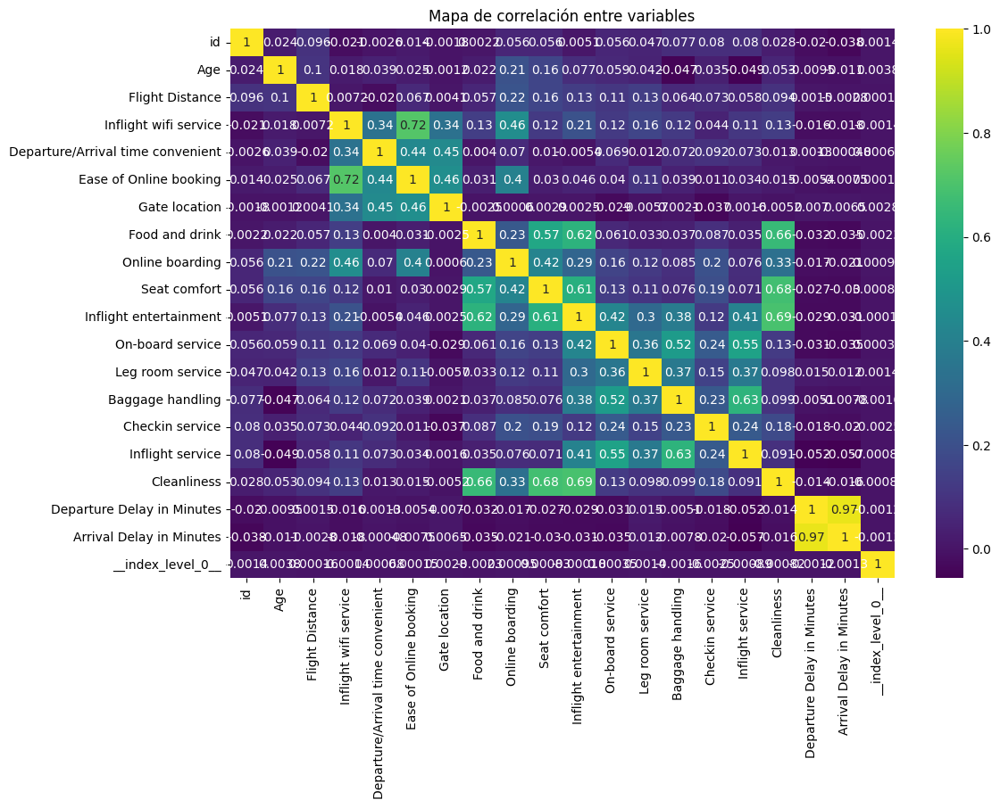

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt

# Calcular la matriz de correlación
correlation_matrix = numeric_data.corr()

# Visualizar el mapa de calor
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='viridis')
plt.title('Mapa de correlación entre variables')
plt.show()

Se puede observar que Departure delay in minutes está altamente correlacionado al arrival delay in minutes, esto es debido a que si hay un retraso para el despegue, el tiempo de vuelo normalmente no varía y afecta en el delay del aterrizaje, por tanto, Arrival Delay in minutes tiene el mismo peso que Departure Delay in Minutes, el resto de las variables no tienen una tan alta correlación, algunos superan el .6, como por ejemplo Seat comfort con Cleanliness o inflight entertaiment con el mismo Cleanliness, también ocurre con food and drink, lo anterior nos dice que al final una mejor ubicación en clases del vuelo tiene esas tres variables que depende de ella, por tanto, las tres variables altamente correlacionadas con Cleanliness no son tan necesarias para el momento de realizar un estudio.

### 5)

In [20]:
from sklearn.decomposition import PCA

pca = PCA(n_components=4)
reduced_data = pca.fit_transform(scaled_data)

Las cuatro variables que se consideran, son las que en las sumas de las varianzas correspondientes a cada variables, suman lo máximo, osea la mayor cantidad de información que se pueda retener.

In [21]:
explained_variance = pca.explained_variance_ratio_
print(f"Varianza explicada por cada componente: {explained_variance}")

Varianza explicada por cada componente: [0.19360427 0.11834872 0.10881595 0.09815158]


## 3. Preprocesamiento 🎭. [10 puntos]

<center>
<img src="https://i.pinimg.com/originals/1e/a8/0e/1ea80e7cea0d429146580c7e91c5b944.gif" width=400>

Tras quedar satisfecho con los resultados presentados en el punto 2, el dueño de la empresa ha solicitado que se preprocesen los datos mediante un `pipeline`. Es crucial que este proceso tenga en cuenta las observaciones derivadas de los análisis anteriores. Adicionalmente, ha expresado su interés en visualizar el conjunto de datos en un gráfico de dos o tres dimensiones.

Basándose en los análisis realizados anteriormente:
1. Cree un `pipeline` que incluya PCA, utilizando las consideraciones mencionadas previamente para proyectar los datos a dos dimensiones. [4 puntos]
2. Grafique los resultados obtenidos y comente lo visualizado. [6 puntos]

**Respuestas:**

In [23]:
from sklearn.pipeline import Pipeline
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

In [25]:
pipeline = Pipeline([
    ('scaler', StandardScaler()),
    ('pca', PCA(n_components=2))
])

pca_result = pipeline.fit_transform(numeric_data)

print(f"Datos transformados con PCA: {pca_result[:5]}")

Datos transformados con PCA: [[ 2.11047034 -1.22609439]
 [-3.40217943  1.24545533]
 [ 2.18754399 -1.94368854]
 [-1.9316335   2.50537851]
 [ 0.84729655  0.20743239]]


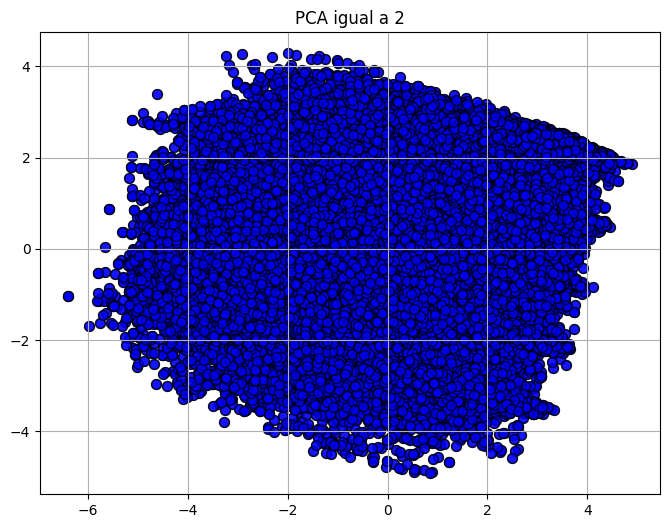

In [27]:
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))

plt.scatter(pca_result[:, 0], pca_result[:, 1], c='blue', edgecolor='k', s=50, alpha=0.7)

plt.title('PCA igual a 2')
plt.grid(True)
plt.show()

El gráfico es claramente dificil de interpretar, dado que no se pueden diferenciar clusters de ningún tipo, esto nos dice que al reducir tanto la dimensionalidad es posible que se pueda perder información.

## 4. Outliers 🚫🙅‍♀️❌🙅‍♂️ [10 puntos]

<center>
<img src="https://joachim-gassen.github.io/images/ani_sim_bad_leverage.gif" width=250>

Con el objetivo de mantener la claridad en su análisis, Don Sergio le ha solicitado entrenar un modelo que identifique pasajeros con comportamientos altamente atípicos.

1. Utilice `IsolationForest` para clasificar las anomalías del dataset (sin aplicar PCA), configurando el modelo para que sólo el 1% de los datos sean considerados anómalos. Asegúrese de integrar esta tarea dentro de un `pipeline`. [3 puntos]

2. Visualice los resultados en el gráfico de dos dimensiones previamente creado. [3 puntos]

3. ¿Cómo evaluaría el rendimiento de su modelo en la detección de anomalías? [4 puntos]

**Respuestas:**

In [34]:
from sklearn.ensemble import IsolationForest

pipeline_2 = Pipeline([
    ('scaler', StandardScaler()),
    ('isolation_forest', IsolationForest(contamination=0.01, random_state=42))
])

pipeline_2.fit(numeric_data)

labels_2 = pipeline_2.named_steps['isolation_forest'].predict(numeric_data)

numeric_data['Anomaly'] = labels_2

print(f"Anomalías detectadas:\n{numeric_data['Anomaly'].value_counts()}")

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but IsolationForest was fitted without feature names



Anomalías detectadas:
Anomaly
 1    137716
-1     98398
Name: count, dtype: int64


## 5. Métricas de Desempeño 🚀 [10 puntos]

<center>
<img src="https://giffiles.alphacoders.com/219/219081.gif" width=300>

Motivado por incrementar su fortuna, Don Sergio le solicita entrenar un modelo que le permita segmentar a los pasajeros en grupos distintos, con el objetivo de optimizar las diversas campañas de marketing diseñadas por su equipo. Para ello, le se pide realizar las siguientes tareas:

1. Utilizar el modelo **Gaussian Mixture** y explore diferentes configuraciones de número de clústers, específicamente entre 3 y 8. Asegúrese de integrar esta operación dentro de un `pipeline`. [4 puntos]
2. Explique cuál sería el criterio adecuado para seleccionar el número óptimo de clústers. **Justifique de forma estadistica y a traves de gráficos.** [6 puntos]

> **HINT:** Se recomienda investigar sobre los criterios AIC y BIC para esta tarea.

**Respuestas:**

In [39]:
from sklearn.mixture import GaussianMixture

def create_gmm_pipeline(n_clusters):

    return Pipeline([
        ('scaler', StandardScaler()),  # Escalado de datos
        ('gmm', GaussianMixture(n_components=n_clusters, random_state=42))  # Modelo GaussianMixture
    ])

n_clusters_range = list(range(3, 9))

aic_scores = []
bic_scores = []

for n_clusters in n_clusters_range:
    gmm_pipeline = create_gmm_pipeline(n_clusters)
    gmm_pipeline.fit(numeric_data)

    gmm_model = gmm_pipeline.named_steps['gmm']

    aic_scores.append(gmm_model.aic(numeric_data))
    bic_scores.append(gmm_model.bic(numeric_data))


print(f"Resultados de AIC para cada número de clústers:{aic_scores}")
print(f"Resultados de BIC para cada número de clústers:{bic_scores}")


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but GaussianMixture was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but GaussianMixture was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but GaussianMixture was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but GaussianMixture was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but GaussianMixture was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but GaussianMixture was fitted without feature names

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:486: UserWarning:

X has feature names, but 

Resultados de AIC para cada número de clústers:[2471727920419565.5, 2415367499939573.0, 2431927000577230.5, 2463874674528490.5, 2422868221739183.5, 2399095969645655.5]
Resultados de BIC para cada número de clústers:[2471727920427427.5, 2415367499950059.0, 2431927000590341.0, 2463874674544225.0, 2422868221757542.0, 2399095969666638.0]


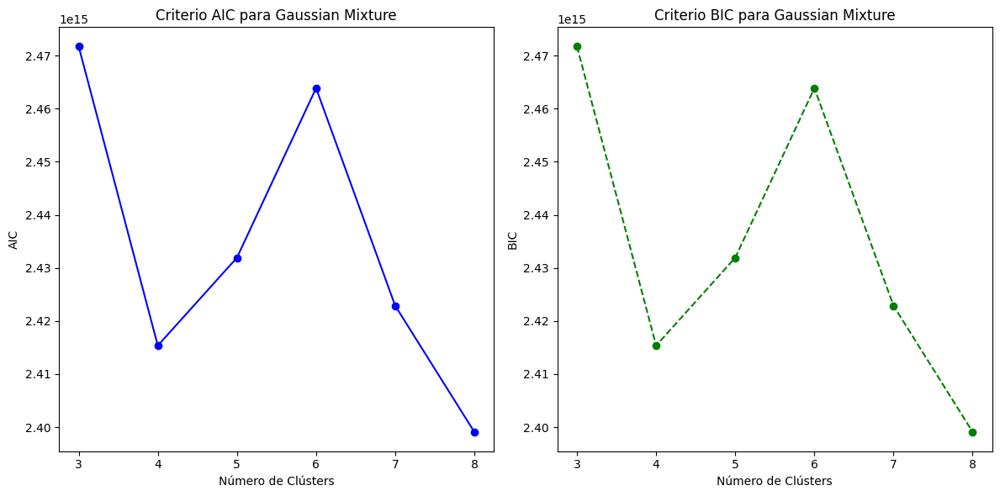

In [40]:

plt.figure(figsize=(12, 6))

# AIC
plt.subplot(1, 2, 1)
plt.plot(n_clusters_range, aic_scores, marker='o', color='blue')
plt.title('Criterio AIC para Gaussian Mixture')
plt.xlabel('Número de Clústers')
plt.ylabel('AIC')
plt.xticks(n_clusters_range)

# BIC
plt.subplot(1, 2, 2)
plt.plot(n_clusters_range, bic_scores, marker='o', linestyle='--', color='green')
plt.title('Criterio BIC para Gaussian Mixture')
plt.xlabel('Número de Clústers')
plt.ylabel('BIC')
plt.xticks(n_clusters_range)

plt.tight_layout()
plt.show()

## 6. Análisis de resultados 📊 [10 puntos]

<center>
<img src="https://i.gifer.com/7wTk.gif" width=300>

Una vez identificado el número óptimo de clústers, se le pide realizar lo siguiente:

1. Utilizar la proyección en dos dimensiones para visualizar cada clúster claramente. [2 puntos]

2. ¿Es posible distinguir claramente entre los clústers generados? [2 puntos]

3. Proporcionar una descripción breve de cada clúster utilizando estadísticas descriptivas básicas, como la media y la desviación estándar, para resumir las características de las variables utilizadas en estos algoritmos. [2 puntos]

4. Proceda a visualizar los clústers en tres dimensiones para una perspectiva más detallada. [2 puntos]

5. ¿Cómo afecta esto a sus conclusiones anteriores? [2 puntos]

**Respuestas:**

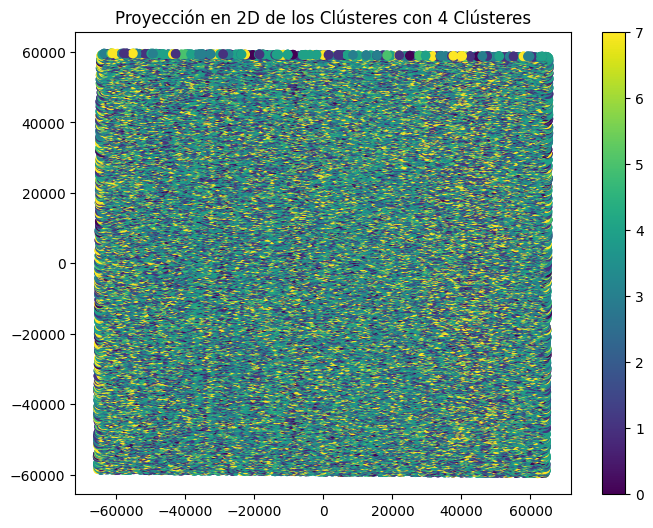

In [46]:
gmm_model = GaussianMixture(n_components=8, random_state=42)
gmm_model.fit(numeric_data)

pca = PCA(n_components=2)
data_2d = pca.fit_transform(numeric_data)

labels = gmm_model.predict(numeric_data)

plt.figure(figsize=(8,6))
plt.scatter(data_2d[:, 0], data_2d[:, 1], c=labels, cmap='viridis')
plt.title('Proyección en 2D de los Clústeres con 4 Clústeres')
plt.colorbar()
plt.show()



Es imposible distinguir los clusters claramente, están todos superpuestos.

In [50]:
import numpy as np

numeric_data['cluster'] = labels

cluster_summary = numeric_data.groupby('cluster').agg([np.mean, np.std])

cluster_summary

<ipython-input-50-e8436edaf6cb>:5: FutureWarning:

The provided callable <function mean at 0x7a180bd3c280> is currently using SeriesGroupBy.mean. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "mean" instead.

<ipython-input-50-e8436edaf6cb>:5: FutureWarning:

The provided callable <function std at 0x7a180bd3c3a0> is currently using SeriesGroupBy.std. In a future version of pandas, the provided callable will be used directly. To keep current behavior pass the string "std" instead.



id                      Age            Flight Distance  \
                 mean           std       mean        std            mean   
cluster                                                                     
0        60865.175190  36510.348585  38.729609  15.360620     1525.375295   
1        64664.314591  37674.711454  32.214130  14.204460      901.514960   
2        61823.416149  36886.618100  32.188997  14.240813      792.208962   
3        68235.582718  37406.683184  49.537779   9.041368     1597.315565   
4        62485.230635  36746.381866  32.173151  14.321794      882.059120   
5        66163.812709  38428.924199  51.829431   9.440596     1242.781865   
6        64307.469105  32833.639724  39.398487  15.975378     2464.614124   
7        67200.274085  38548.537408  49.205253   9.109705     1649.335885   

                     Inflight wifi service            \
                 std                  mean       std   
cluster                                                
0        1081.969752              2.688959  1.255661   
1         740.241821              2.686220  1.216881   
2         660.275294              2.436557  1.402149   
3        1134.182868              2.800829  1.414236   
4         747.133109              2.758077  1.310364   
5        1046.176726              2.512263  1.382298   
6         837.559588              2.662043  1.408146   
7        1174.920877              2.748257  1.366853   

        Departure/Arrival time convenient            ... Cleanliness  \
                                     mean       std  ...        mean   
cluster                                              ...               
0                                3.070548  1.475485  ...    3.293470   
1                                3.082715  1.510825  ...    3.155765   
2                                2.803904  1.739060  ...    3.002662   
3                                3.056421  1.475658  ...    3.500059   
4                                3.065287  1.576849  ...    3.187227   
5                                3.238945  1.546139  ...    3.524526   
6                                2.881463  1.565744  ...    3.310214   
7                                3.001743  1.460947  ...    3.357107   

                  Departure Delay in Minutes              \
              std                       mean         std   
cluster                                                    
0        1.331446                 148.035405  114.784581   
1        1.353445                  24.955802   28.233580   
2        1.407133                   1.729370    5.410215   
3        1.204433                   0.758966    2.129991   
4        1.361497                   0.742204    2.156930   
5        1.190275                  24.347826   27.367326   
6        1.352501                   0.899117    2.620456   
7        1.242445                  19.897747   26.136913   

        Arrival Delay in Minutes             __index_level_0__                \
                            mean         std              mean           std   
cluster                                                                        
0                     155.503541  111.385348      58672.246525  34668.136379   
1                      26.678731   27.371296      58967.067331  34105.739489   
2                       1.969831    2.130838      59316.889973  33578.299611   
3                       0.025883    0.158787      59342.839613  34158.644264   
4                       0.000000    0.000000      59177.228758  34223.605151   
5                      26.790227   27.607677      59396.000186  34317.868983   
6                       0.343001    1.124829      58016.035309  34709.517715   
7                      20.566716   25.322867      59532.181977  34169.907027   

          Anomaly            
             mean       std  
cluster                      
0       -1.000000  0.000000  
1       -1.000000  0.000000  
2        1.000000  0.000000  
3        1.000000  0.000000  
4        

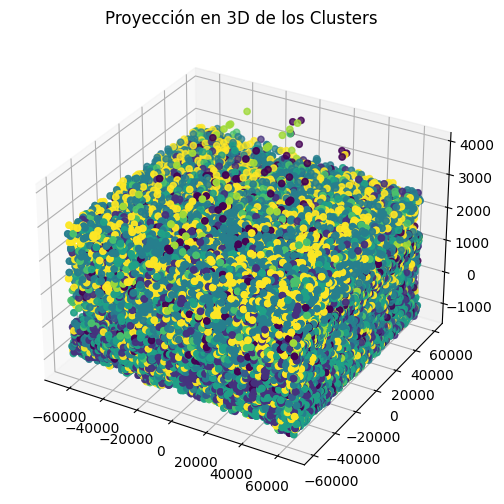

In [49]:
from mpl_toolkits.mplot3d import Axes3D

pca_3d = PCA(n_components=3)
data_3d = pca_3d.fit_transform(numeric_data.drop(columns=['cluster']))


fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(data_3d[:, 0], data_3d[:, 1], data_3d[:, 2], c=labels, cmap='viridis')
ax.set_title('Proyección en 3D de los Clusters')
plt.show()


No afecta en nada a las conclusiones anteriores, los clusters no muestran una separación clara, por lo tanto, no es posible concluir de buena manera.